# DCGANs Pytorch implementation

## Generative Adversarial Network (GAN)
GANs are a framework for teaching a deep learning models to learn the training data's distribution so that it can generate new data with the same distribution.

They were invented by Ian Goodfellow in 2014, described in the paper [Generative Adversarial Nets](https://papers.nips.cc/paper/2014/file/5ca3e9b122f61f8f06494c97b1afccf3-Paper.pdf). They are made up of two  distinct models, a *generator* and a *discriminator*. Where the job of the generator is to create 'fake' images that look like the training data, whilst the discriminators job is to look at the generated image and output whether or not is a real training image or a fake image. During the training phase, the generator is constantly trying to outsmart the discrimintator and produce better and better fakes, while the discriminator is working to be come a better detective and correctly classify the real and fake images. The equilibrium to this game is when the generatror is generating perfect fakes that look as if they have came directly from the training data, whilst the discriminator is left to always guess at 50% confidence that the generator output is real or fake. 

### Notation

#### Discriminator Notation
*x* = data representing an image, it can be real or fake.
*D(x)* = discriminator network (i.e. function) which outputs a probability that *x* came from the training data rather than the generator. The function *D(x)8 can be thought of a traditional *binary classifier* such that *D(x)* should be HIGH i.e. 1 when *x* is real, and LOW i.e. 0 when *x* is fake.

#### Generator Notation
*z* = latent space vector sampled from a standard normal distribution, where the latent space is a representation of compressed data
*G(x)* = generator network (i.e. function) which maps the latent vector *z* to data-space. 

**Finsh understanding this from papers**

## Deep Convolutional Generatiev Adversarial Network (DCGAN)
Direct extension of the GAN described above, except that it explicitly uses convolutional and convolutional-transpose layers in the discriminator and generator, respectively. **What are convolution and convolutional-transpose layers?**

Described by Radford et. al. in the paper [Unsupervised Representation Learning With Deep Convolutional Generative Advarsarial Networks](https://arxiv.org/pdf/1511.06434.pdf). The discriminator is made up of strided convolution layers, batch norm layers, and LeakyReLU activations. The inout is a 3x64x64 input image and the output is a scalar probability that the input is from the real data distribution.
The generator is comprised of convolutional-transpose layers, batch norm layers, and ReLU activation. The input is a latent vector *z* that is drawn from a standard normal distribution and the putput is a 3x64x64 RGB image. The strided conv-transpose layers allow the latent vector to be transformed into a volume with the same shape as an image 

**Understand this more**

In [1]:
from __future__ import print_function

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from torchvision import models
from IPython.display import HTML
import time

# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)

# Seed() method used to initialise a random number generator
# The random number generator requires a number to start with (seed value) to be able to generate a random number
# If you the same seed value you'll get the same set of random numbers
random.seed(manualSeed)

# Sets the seed for randomly generating values with pytorch
torch.manual_seed(manualSeed)

Random Seed:  999


## Define inputs

**dataroot** - path to the root of the dataset folder. Needs to have sub directories in the dataset's root folder for ImageFolder to work.
**workers** - number of worker threads for loading the data with the DataLoader
**batch_size** - the batch size used in training, where the batch size refers to number of data points used in each round of training. The DCGAN paper uses a batch size of 128
**image_size** - the spatial size of the images used for training. All images will be resized to this size using a transformer. It is set to a default of 64x64, if another size is desired, the structures of D and G must be changed. See [here](https://github.com/pytorch/examples/issues/70) for details.
**nc** - number of color channels in the input images. For color images this is 3
**nz** - size of z latent vector (i.e. size of generator input)
**ngf** - relates to the depth of feature maps carried through the generator
**ndf** - sets the depth of feature maps propagated through the discriminator
**num_epochs** - number of training epochs to run. Training for longer will probably lead to beter results but will also take much longer

**lr** - learning rate for training. As described in the DCGAN paper, this number should be 0.0002
**beta1** - beta1 hyperparameter for Adam optimizers. As described in paper, this number should be 0.5
**ngpu** - number of GPUs available. If this is 0, code will run in CPU mode. If this number is greater than 0 it will run on that number of GPUs.

In [2]:
## Dataroots for the different datasets
home_dir = "/home/a/Projects/dcgans-2d-pytorch/" # on machine
ext_dir = "/media/a/Seagate Basic/home/a/Projects/dggan-pytorch-2d-images/" # on external hard drive

## Celeba Dataset: 
# dataset_name = "celeba"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/celeba/"

## Scan The World main dataset:
# dataset_name = "scan-the-world-main-images"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/scan-the-world-main-images/"

## 2D Scan The World busts dataset: 
# dataset_name = "scan-the-world-busts-images"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/scan-the-world-busts-images/"

## Mixed god dataset:
# dataset_name = "mixed-gods"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/mixed-gods/"

# Sanitised mixed god dataset
# dataset_name = "sanitised-mixed-gods"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/sanitised-mixed-gods/"

# Sanitised mixed god dataset
# dataset_name = "sanitised-mixed-gods-scan-the-world"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/sanitised-mixed-gods-scan-the-world/"

# Unsanitised full dataset
# dataset_name = "unsanitised-full-dataset"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/all-scan-the-world-images/"

# # Facial recognition full dataset
# dataset_name = "facerecog-recog-full-dataset"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/facerecog-all-scan-the-world/"

# Tags classifier - busts
# dataset_name = "tags-classifier-fullbody"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/busts-tags-classifier/"
    
# Tags classifier - fullbody
# dataset_name = "tags-classifier-fullbody-seed-1312"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/fullbody-tags-classifier/"

# Fully manually sanitised fullbody dataset
dataset_name = "fully-manually-sanitised-fullbody-dataset-dropout-layers-in-G"
dataroot = ext_dir + "data/fully-manually-sanitised-fullbody-dataset/"

# Fully manually sanitised busts dataset
# dataset_name = "fully-manually-sanitised-busts-dataset"
# dataroot = ext_dir + "data/fully-manually-sanitised-busts-dataset/"

workers = 2 
batch_size = 128
image_size = 64 
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 100
lr = 0.0002
beta1 = 0.5
ngpu = 1

In [3]:
# Make output directory
results_dir = "results_" + dataset_name + "_epochs_" + str(num_epochs) + "_" + time.strftime("%Y%m%d-%H%M%S")
path = os.path.join(home_dir + "outputs", results_dir)
os.mkdir(path)

# Prepare the dataset

We begin by loading in the dataset using *ImageFolder* which is aa pytorch method to help with transforming datasets. 
It takes as parameters the root to the dataset directory as well as a transform, which is a function which describes the transformation that need to be performed on the original image
In this case it takes each image and resizes to the given *image_size*, then crops the given image at the center, converts it to a tensor and then normalises it
**TODO whta is a tensor, why normalise**

Then we create a dataloader for the dataset, where a dataloader is a class that helps to parallelize the data loading process with the support of automatic batching as well. We need this as if we were to load in the large datasets into memory all at once we would get memory outages and slowing down of programs.

**Add parameters properly to all of these**

Then set the device we want to train the models on. This will be set to the first GPU i.e. "cuda:0" if pytorch can detect a cuda-enable device and ngpu is greater than 0, else it will run it on the CPU. Note it is considerably faster to run on GPU.

Finally plot some of the transformed dataset points before any training has begun
**Understand matlab plotting better**

Size of the dataset:  32490


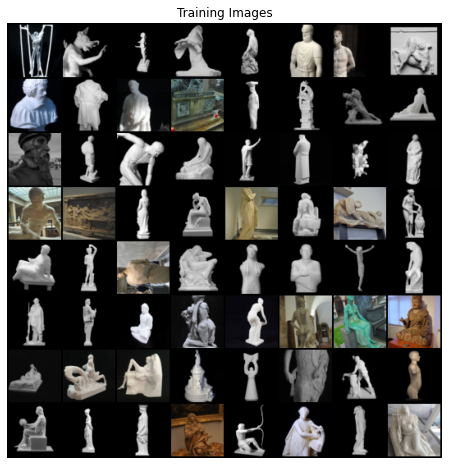

In [4]:
# Create dataset by standardising and normalizing the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Create the dataloader - python iterable over the dataset
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

dataset_size = len(dataloader.dataset)
print("Size of the dataset: ", dataset_size)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images before any training has begun
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Implementation
All functions to be defined
- Weight initialization strategy
- Generator 
- Discriminator
- Loss functions
- Training loop

# Weight Initialization
From the DCGAN paper, the authors specify that all model weights shall be randomly initialiseed from a normal distribution with mean=0, stdev=0.02. The *weight_init* function takes an initialised model as input and reinitalises all convolutional, convolutional-transpose, and batch normalisation layers to meet this criteria. This function is applied to the models immediately after initialisation

**TODO: understand the __class__.name__ syntak amd why we have the line nn.init.constant_(m.bias.data, 0)**

In [5]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Define the generator class
The generator, *G*, is designed to map the latent space vector (z) to data-space. Since our data are images, converting *z* to data-space means ultimately creating a RGB image with the same size as the training images (i.e. 3x64x64). In practice, this is accomplished through a series of strided two dimensional convolutional transpose layers, each paired with a 2d batch norm layer and a relu activation. The output of the generator is fed through a tanh function to return it to the input data range of [−1,1]. It is worth noting the existence of the batch norm functions after the conv-transpose layers, as this is a critical contribution of the DCGAN paper. These layers help with the flow of gradients during training.

**TODO understand convolutional networks and what strided convolutional tranpose, batch norm and relu activation do**

Notice, the how the inputs we set in the input section (nz, ngf, and nc) influence the generator architecture in code. nz is the length of the z input vector, ngf relates to the size of the feature maps that are propagated through the generator, and nc is the number of channels in the output image (set to 3 for RGB images).

In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.Dropout(p=0.5),
            
            # state size. (ngf*8) x 4 x 4          
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
    
            
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
         
            
            # state size. (ngf*2) x 16 x 16
            
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            # state size. (ngf) x 32 x 32
            
            
            
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

# Create generator instance and apply weights_init function

Now, we can instantiate the generator and apply the weights_init function. Check out the printed model to see how the generator object is structured.

In [7]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Dropout(p=0.5, inplace=False)
    (4): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (11): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1,

# Define the discrimintator class
As mentioned, the discriminator, *D*, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real (as opposed to fake). Here, D takes a 3x64x64 input image, processes it through a series of Conv2d, BatchNorm2d, and LeakyReLU layers, and outputs the final probability through a Sigmoid activation function. This architecture can be extended with more layers if necessary for the problem, but there is significance to the use of the strided convolution, BatchNorm, and LeakyReLUs. The DCGAN paper mentions it is a good practice to use strided convolution rather than pooling to downsample because it lets the network learn its own pooling function. Also batch norm and leaky relu functions promote healthy gradient flow which is critical for the learning process of both G and D.

**TODO Consider adding a few more layers**

In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
        
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Create discriminator instance and apply weights_init function

Now, we can instantiate the discriminator and apply the weights_init function. Check out the printed model to see how the discrimintator object is structured.

In [9]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


# Define Loss functions and Optimizers
With D and G setup, we can specify how they learn through the loss functions and optimizers. We will use the Binary Cross Entropy loss (BCELoss) function.

**TODO understand the loss function better here**
Notice how this function provides the calculation of both log components in the objective function (i.e. log(D(x)) and log(1−D(G(z)))). We can specify what part of the BCE equation to use with the y input. This is accomplished in the training loop which is coming up soon, but it is important to understand how we can choose which component we wish to calculate just by changing y (i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These labels will be used when calculating the losses of D and G, and this is also the convention used in the original GAN paper. Finally, we set up two separate optimizers, one for D and one for G. As specified in the DCGAN paper, both are Adam optimizers with learning rate 0.0002 and Beta1 = 0.5. For keeping track of the generator’s learning progression, we will generate a fixed batch of latent vectors that are drawn from a Gaussian distribution (i.e. fixed_noise) . In the training loop, we will periodically input this fixed_noise into G, and over the iterations we will see images form out of the noise.

In [10]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
import csv
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
D_fake_losses = []
D_real_losses = []
D_x_acc = []
D_G_z1_acc = []
D_G_z2_acc = []
iters = 0

wtr = csv.writer(open (os.path.join(path,'training_stats.csv'), 'w', newline=''))
wtr.writerow(["Current Epoch", "Total number of epochs", "Iteration", "Batch_size", "D_losses", "D_fake_losses", "D_real_losses", "G_losses", "D_accuracy", "D_G_z1_accurancy", "D_G_z2_accuracy"])
print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output - note this is loss on fake 
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_D_fake: %.4f\tLoss_D_real: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errD_fake.item(), errD_real.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            wtr.writerow([epoch, num_epochs, i, len(dataloader), errD.item(), errD_fake.item(), errD_real.item(), errG.item(), D_x, D_G_z1, D_G_z2])

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        D_fake_losses.append(errD_fake.item())
        D_real_losses.append(errD_real.item())
        D_x_acc.append(D_x)
        D_G_z1_acc.append(D_G_z1)
        D_G_z2_acc.append(D_G_z2)
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/254]	Loss_D: 1.7356	Loss_D_fake: 1.0103	Loss_D_real: 0.7253	Loss_G: 3.4435	D(x): 0.5333	D(G(z)): 0.5665 / 0.0476
[0/100][50/254]	Loss_D: 0.0098	Loss_D_fake: 0.0045	Loss_D_real: 0.0052	Loss_G: 8.4658	D(x): 0.9949	D(G(z)): 0.0045 / 0.0003
[0/100][100/254]	Loss_D: 0.0002	Loss_D_fake: 0.0000	Loss_D_real: 0.0002	Loss_G: 35.0490	D(x): 0.9998	D(G(z)): 0.0000 / 0.0000
[0/100][150/254]	Loss_D: 0.0004	Loss_D_fake: 0.0000	Loss_D_real: 0.0004	Loss_G: 38.0545	D(x): 0.9996	D(G(z)): 0.0000 / 0.0000
[0/100][200/254]	Loss_D: 0.0009	Loss_D_fake: 0.0000	Loss_D_real: 0.0009	Loss_G: 37.8872	D(x): 0.9991	D(G(z)): 0.0000 / 0.0000
[0/100][250/254]	Loss_D: 0.0000	Loss_D_fake: 0.0000	Loss_D_real: 0.0000	Loss_G: 37.7077	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[1/100][0/254]	Loss_D: 0.0001	Loss_D_fake: 0.0000	Loss_D_real: 0.0001	Loss_G: 37.7274	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
[1/100][50/254]	Loss_D: 0.0000	Loss_D_fake: 0.0000	Loss_D_real: 0.0000	Loss_G: 37.6936	D(x): 1.0000

[11/100][0/254]	Loss_D: 1.2591	Loss_D_fake: 0.9064	Loss_D_real: 0.3528	Loss_G: 2.1683	D(x): 0.7233	D(G(z)): 0.5499 / 0.1505
[11/100][50/254]	Loss_D: 0.7558	Loss_D_fake: 0.1742	Loss_D_real: 0.5817	Loss_G: 2.2009	D(x): 0.5971	D(G(z)): 0.1504 / 0.1480
[11/100][100/254]	Loss_D: 0.8681	Loss_D_fake: 0.6671	Loss_D_real: 0.2010	Loss_G: 2.2926	D(x): 0.8479	D(G(z)): 0.4346 / 0.1320
[11/100][150/254]	Loss_D: 0.7832	Loss_D_fake: 0.1903	Loss_D_real: 0.5929	Loss_G: 1.5935	D(x): 0.5945	D(G(z)): 0.1566 / 0.2638
[11/100][200/254]	Loss_D: 0.9513	Loss_D_fake: 0.8018	Loss_D_real: 0.1495	Loss_G: 2.6655	D(x): 0.8723	D(G(z)): 0.5079 / 0.0960
[11/100][250/254]	Loss_D: 0.9713	Loss_D_fake: 0.3346	Loss_D_real: 0.6367	Loss_G: 1.3484	D(x): 0.5742	D(G(z)): 0.2618 / 0.3202
[12/100][0/254]	Loss_D: 1.9633	Loss_D_fake: 1.8114	Loss_D_real: 0.1519	Loss_G: 3.0388	D(x): 0.8692	D(G(z)): 0.7934 / 0.0728
[12/100][50/254]	Loss_D: 0.7403	Loss_D_fake: 0.4014	Loss_D_real: 0.3389	Loss_G: 1.9614	D(x): 0.7361	D(G(z)): 0.3107 / 0.172

[22/100][0/254]	Loss_D: 0.6700	Loss_D_fake: 0.3885	Loss_D_real: 0.2815	Loss_G: 2.6112	D(x): 0.7794	D(G(z)): 0.2930 / 0.1076
[22/100][50/254]	Loss_D: 0.6386	Loss_D_fake: 0.3586	Loss_D_real: 0.2800	Loss_G: 2.3609	D(x): 0.7699	D(G(z)): 0.2773 / 0.1233
[22/100][100/254]	Loss_D: 0.8357	Loss_D_fake: 0.2566	Loss_D_real: 0.5791	Loss_G: 1.5919	D(x): 0.6090	D(G(z)): 0.2009 / 0.2633
[22/100][150/254]	Loss_D: 0.7221	Loss_D_fake: 0.1485	Loss_D_real: 0.5736	Loss_G: 1.7117	D(x): 0.5945	D(G(z)): 0.1317 / 0.2293
[22/100][200/254]	Loss_D: 1.2889	Loss_D_fake: 1.2080	Loss_D_real: 0.0810	Loss_G: 4.2174	D(x): 0.9284	D(G(z)): 0.6454 / 0.0250
[22/100][250/254]	Loss_D: 0.7498	Loss_D_fake: 0.1882	Loss_D_real: 0.5616	Loss_G: 1.1646	D(x): 0.6209	D(G(z)): 0.1571 / 0.3725
[23/100][0/254]	Loss_D: 0.9200	Loss_D_fake: 0.1015	Loss_D_real: 0.8185	Loss_G: 1.4228	D(x): 0.4941	D(G(z)): 0.0915 / 0.3107
[23/100][50/254]	Loss_D: 0.8302	Loss_D_fake: 0.5945	Loss_D_real: 0.2357	Loss_G: 3.2189	D(x): 0.8101	D(G(z)): 0.4153 / 0.054

[33/100][0/254]	Loss_D: 0.4916	Loss_D_fake: 0.1958	Loss_D_real: 0.2958	Loss_G: 2.7471	D(x): 0.7596	D(G(z)): 0.1631 / 0.0957
[33/100][50/254]	Loss_D: 0.4701	Loss_D_fake: 0.1435	Loss_D_real: 0.3266	Loss_G: 2.1239	D(x): 0.7576	D(G(z)): 0.1214 / 0.1694
[33/100][100/254]	Loss_D: 0.6080	Loss_D_fake: 0.0571	Loss_D_real: 0.5509	Loss_G: 1.6420	D(x): 0.6188	D(G(z)): 0.0540 / 0.2525
[33/100][150/254]	Loss_D: 0.6436	Loss_D_fake: 0.0987	Loss_D_real: 0.5449	Loss_G: 1.9135	D(x): 0.6297	D(G(z)): 0.0861 / 0.2028
[33/100][200/254]	Loss_D: 1.0869	Loss_D_fake: 0.1528	Loss_D_real: 0.9340	Loss_G: 0.9788	D(x): 0.4913	D(G(z)): 0.1259 / 0.4539
[33/100][250/254]	Loss_D: 0.7449	Loss_D_fake: 0.6415	Loss_D_real: 0.1035	Loss_G: 3.5591	D(x): 0.9063	D(G(z)): 0.4285 / 0.0405
[34/100][0/254]	Loss_D: 0.5473	Loss_D_fake: 0.3383	Loss_D_real: 0.2090	Loss_G: 3.1461	D(x): 0.8242	D(G(z)): 0.2652 / 0.0627
[34/100][50/254]	Loss_D: 0.5406	Loss_D_fake: 0.3072	Loss_D_real: 0.2333	Loss_G: 3.0722	D(x): 0.8082	D(G(z)): 0.2326 / 0.074

[44/100][0/254]	Loss_D: 0.3307	Loss_D_fake: 0.1385	Loss_D_real: 0.1923	Loss_G: 2.1370	D(x): 0.8341	D(G(z)): 0.1187 / 0.1753
[44/100][50/254]	Loss_D: 0.4210	Loss_D_fake: 0.1842	Loss_D_real: 0.2369	Loss_G: 3.3393	D(x): 0.8089	D(G(z)): 0.1415 / 0.0577
[44/100][100/254]	Loss_D: 0.3122	Loss_D_fake: 0.1809	Loss_D_real: 0.1313	Loss_G: 3.0767	D(x): 0.8866	D(G(z)): 0.1539 / 0.0630
[44/100][150/254]	Loss_D: 0.6134	Loss_D_fake: 0.3385	Loss_D_real: 0.2748	Loss_G: 2.3229	D(x): 0.7850	D(G(z)): 0.2436 / 0.1482
[44/100][200/254]	Loss_D: 0.6063	Loss_D_fake: 0.0501	Loss_D_real: 0.5562	Loss_G: 2.0435	D(x): 0.6198	D(G(z)): 0.0468 / 0.1928
[44/100][250/254]	Loss_D: 0.4053	Loss_D_fake: 0.0853	Loss_D_real: 0.3201	Loss_G: 2.3584	D(x): 0.7633	D(G(z)): 0.0785 / 0.1409
[45/100][0/254]	Loss_D: 0.2403	Loss_D_fake: 0.1541	Loss_D_real: 0.0862	Loss_G: 2.8176	D(x): 0.9199	D(G(z)): 0.1303 / 0.0936
[45/100][50/254]	Loss_D: 0.5767	Loss_D_fake: 0.5492	Loss_D_real: 0.0274	Loss_G: 4.7851	D(x): 0.9734	D(G(z)): 0.3709 / 0.013

[55/100][0/254]	Loss_D: 0.1485	Loss_D_fake: 0.1369	Loss_D_real: 0.0116	Loss_G: 4.4102	D(x): 0.9886	D(G(z)): 0.1158 / 0.0202
[55/100][50/254]	Loss_D: 0.3893	Loss_D_fake: 0.3700	Loss_D_real: 0.0193	Loss_G: 5.4789	D(x): 0.9812	D(G(z)): 0.2639 / 0.0089
[55/100][100/254]	Loss_D: 0.4166	Loss_D_fake: 0.3762	Loss_D_real: 0.0404	Loss_G: 3.9025	D(x): 0.9614	D(G(z)): 0.2700 / 0.0328
[55/100][150/254]	Loss_D: 0.2519	Loss_D_fake: 0.0472	Loss_D_real: 0.2047	Loss_G: 3.3281	D(x): 0.8326	D(G(z)): 0.0446 / 0.0645
[55/100][200/254]	Loss_D: 0.2015	Loss_D_fake: 0.1174	Loss_D_real: 0.0841	Loss_G: 3.5749	D(x): 0.9238	D(G(z)): 0.1034 / 0.0441
[55/100][250/254]	Loss_D: 0.2124	Loss_D_fake: 0.1115	Loss_D_real: 0.1009	Loss_G: 4.1679	D(x): 0.9106	D(G(z)): 0.0982 / 0.0277
[56/100][0/254]	Loss_D: 0.2024	Loss_D_fake: 0.0877	Loss_D_real: 0.1147	Loss_G: 4.0594	D(x): 0.8997	D(G(z)): 0.0720 / 0.0365
[56/100][50/254]	Loss_D: 0.2465	Loss_D_fake: 0.1627	Loss_D_real: 0.0839	Loss_G: 4.2675	D(x): 0.9237	D(G(z)): 0.1412 / 0.026

[66/100][0/254]	Loss_D: 0.3093	Loss_D_fake: 0.1530	Loss_D_real: 0.1563	Loss_G: 3.7736	D(x): 0.8711	D(G(z)): 0.1262 / 0.0457
[66/100][50/254]	Loss_D: 0.2072	Loss_D_fake: 0.0488	Loss_D_real: 0.1584	Loss_G: 3.1707	D(x): 0.8690	D(G(z)): 0.0458 / 0.0749
[66/100][100/254]	Loss_D: 0.2169	Loss_D_fake: 0.0600	Loss_D_real: 0.1568	Loss_G: 3.7072	D(x): 0.8662	D(G(z)): 0.0549 / 0.0463
[66/100][150/254]	Loss_D: 0.2710	Loss_D_fake: 0.0498	Loss_D_real: 0.2212	Loss_G: 2.4343	D(x): 0.8191	D(G(z)): 0.0463 / 0.1319
[66/100][200/254]	Loss_D: 0.1185	Loss_D_fake: 0.0794	Loss_D_real: 0.0391	Loss_G: 4.3485	D(x): 0.9625	D(G(z)): 0.0719 / 0.0229
[66/100][250/254]	Loss_D: 0.1635	Loss_D_fake: 0.1209	Loss_D_real: 0.0426	Loss_G: 3.9069	D(x): 0.9605	D(G(z)): 0.1054 / 0.0313
[67/100][0/254]	Loss_D: 0.1513	Loss_D_fake: 0.1023	Loss_D_real: 0.0490	Loss_G: 4.3507	D(x): 0.9532	D(G(z)): 0.0889 / 0.0225
[67/100][50/254]	Loss_D: 1.2855	Loss_D_fake: 0.2869	Loss_D_real: 0.9986	Loss_G: 0.8928	D(x): 0.4230	D(G(z)): 0.2266 / 0.476

[77/100][0/254]	Loss_D: 0.0479	Loss_D_fake: 0.0244	Loss_D_real: 0.0235	Loss_G: 5.0757	D(x): 0.9770	D(G(z)): 0.0236 / 0.0137
[77/100][50/254]	Loss_D: 0.1568	Loss_D_fake: 0.0216	Loss_D_real: 0.1353	Loss_G: 3.7438	D(x): 0.8809	D(G(z)): 0.0206 / 0.0574
[77/100][100/254]	Loss_D: 0.2110	Loss_D_fake: 0.0630	Loss_D_real: 0.1480	Loss_G: 2.8514	D(x): 0.8726	D(G(z)): 0.0570 / 0.1127
[77/100][150/254]	Loss_D: 3.4644	Loss_D_fake: 0.0031	Loss_D_real: 3.4613	Loss_G: 0.0253	D(x): 0.0873	D(G(z)): 0.0031 / 0.9762
[77/100][200/254]	Loss_D: 0.4234	Loss_D_fake: 0.4101	Loss_D_real: 0.0133	Loss_G: 5.0651	D(x): 0.9870	D(G(z)): 0.2853 / 0.0137
[77/100][250/254]	Loss_D: 0.3339	Loss_D_fake: 0.1976	Loss_D_real: 0.1363	Loss_G: 3.9917	D(x): 0.8890	D(G(z)): 0.1592 / 0.0330
[78/100][0/254]	Loss_D: 0.6615	Loss_D_fake: 0.0311	Loss_D_real: 0.6304	Loss_G: 2.5641	D(x): 0.6284	D(G(z)): 0.0283 / 0.2005
[78/100][50/254]	Loss_D: 0.2469	Loss_D_fake: 0.2120	Loss_D_real: 0.0349	Loss_G: 4.2663	D(x): 0.9667	D(G(z)): 0.1671 / 0.023

[88/100][0/254]	Loss_D: 0.6744	Loss_D_fake: 0.4509	Loss_D_real: 0.2235	Loss_G: 2.9749	D(x): 0.8271	D(G(z)): 0.3008 / 0.1152
[88/100][50/254]	Loss_D: 0.1191	Loss_D_fake: 0.1073	Loss_D_real: 0.0118	Loss_G: 4.7501	D(x): 0.9885	D(G(z)): 0.0742 / 0.0207
[88/100][100/254]	Loss_D: 0.2046	Loss_D_fake: 0.0104	Loss_D_real: 0.1941	Loss_G: 4.8477	D(x): 0.8363	D(G(z)): 0.0100 / 0.0217
[88/100][150/254]	Loss_D: 0.0960	Loss_D_fake: 0.0475	Loss_D_real: 0.0485	Loss_G: 4.6217	D(x): 0.9549	D(G(z)): 0.0358 / 0.0231
[88/100][200/254]	Loss_D: 0.2070	Loss_D_fake: 0.0485	Loss_D_real: 0.1584	Loss_G: 2.6581	D(x): 0.8700	D(G(z)): 0.0454 / 0.1321
[88/100][250/254]	Loss_D: 0.0916	Loss_D_fake: 0.0726	Loss_D_real: 0.0190	Loss_G: 5.4165	D(x): 0.9818	D(G(z)): 0.0638 / 0.0094
[89/100][0/254]	Loss_D: 0.1469	Loss_D_fake: 0.0185	Loss_D_real: 0.1284	Loss_G: 4.5556	D(x): 0.8861	D(G(z)): 0.0178 / 0.0287
[89/100][50/254]	Loss_D: 0.0625	Loss_D_fake: 0.0322	Loss_D_real: 0.0303	Loss_G: 4.6620	D(x): 0.9707	D(G(z)): 0.0301 / 0.019

[99/100][0/254]	Loss_D: 0.1473	Loss_D_fake: 0.1256	Loss_D_real: 0.0217	Loss_G: 5.2442	D(x): 0.9790	D(G(z)): 0.1003 / 0.0122
[99/100][50/254]	Loss_D: 0.1936	Loss_D_fake: 0.0339	Loss_D_real: 0.1597	Loss_G: 3.5291	D(x): 0.8727	D(G(z)): 0.0323 / 0.0691
[99/100][100/254]	Loss_D: 0.0535	Loss_D_fake: 0.0290	Loss_D_real: 0.0246	Loss_G: 5.1812	D(x): 0.9768	D(G(z)): 0.0276 / 0.0130
[99/100][150/254]	Loss_D: 0.0430	Loss_D_fake: 0.0122	Loss_D_real: 0.0308	Loss_G: 6.1084	D(x): 0.9704	D(G(z)): 0.0116 / 0.0066
[99/100][200/254]	Loss_D: 0.0933	Loss_D_fake: 0.0232	Loss_D_real: 0.0701	Loss_G: 4.6723	D(x): 0.9356	D(G(z)): 0.0225 / 0.0202
[99/100][250/254]	Loss_D: 0.0474	Loss_D_fake: 0.0154	Loss_D_real: 0.0320	Loss_G: 5.1184	D(x): 0.9693	D(G(z)): 0.0144 / 0.0177


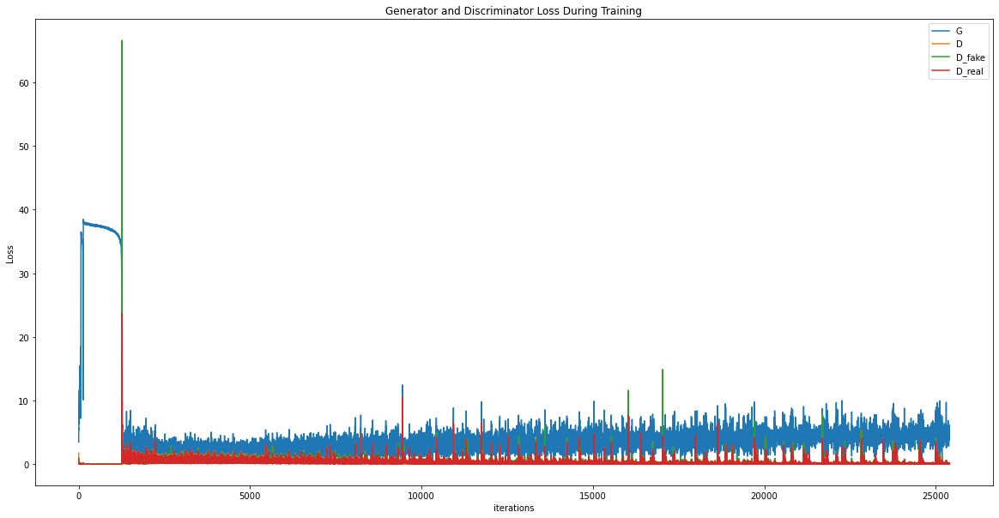

In [12]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.plot(D_fake_losses,label="D_fake")
plt.plot(D_real_losses,label="D_real")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig(os.path.join(path,"generator_discriminator_losses.png"))

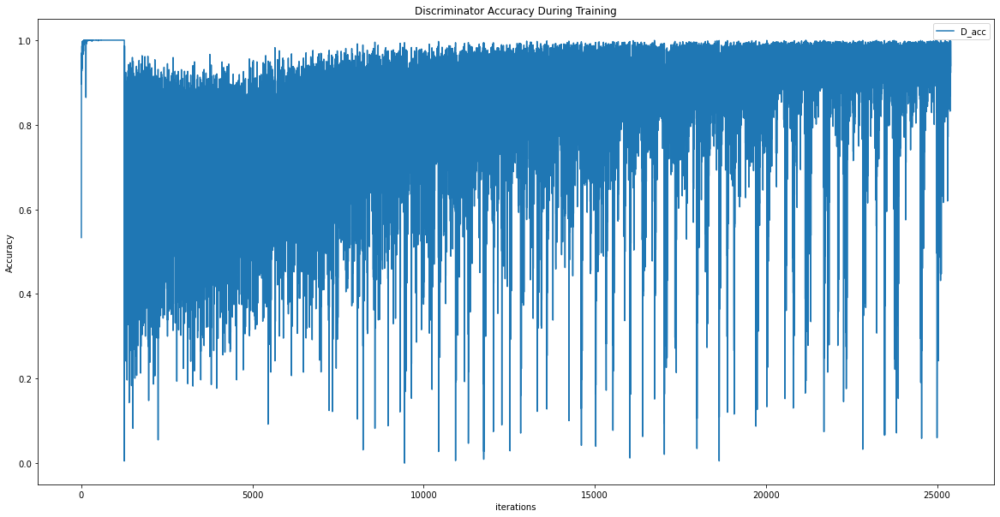

In [13]:
plt.figure(figsize=(20,10))
plt.title("Discriminator Accuracy During Training")
plt.plot(D_x_acc,label="D_acc")
plt.xlabel("iterations")
plt.ylabel("Accuracy")
plt.legend()
plt.savefig(os.path.join(path,"discriminator_accuracy.png"))

In [14]:
from scipy import stats


d_losses_mode = stats.mode(D_losses)
d_fake_losses_mode = stats.mode(D_fake_losses)
d_real_losses_mode = stats.mode(D_real_losses)
g_losses_mode = stats.mode(G_losses)

f = open(os.path.join(path,"overall_stats.txt"), "a")
f.write("Dataset: \t" + dataset_name +"\n")
f.write("Dataset size: \t" + str(dataset_size) +"\n")
f.write("D_losses mean: \t" + str(np.mean(D_losses)) +"\n")
f.write("D_losses mode: \t" + str(d_losses_mode.mode[0]) +"\n")
f.write("D_fake_losses mean: \t" + str(np.mean(D_fake_losses)) +"\n")
f.write("D_fake_losses mode: \t" + str(d_fake_losses_mode.mode[0]) +"\n")
f.write("D_real_losses mean: \t" + str(np.mean(D_real_losses)) +"\n")
f.write("D_real_losses mode: \t" + str(d_real_losses_mode.mode[0]) +"\n")
f.write("G_losses mean: \t" + str(np.mean(G_losses)) +"\n")
f.write("G_losses mode: \t" + str(g_losses_mode.mode[0]) +"\n")
f.write("Discriminator accuracy mean \t" + str(np.mean(D_x_acc)))

f.close()

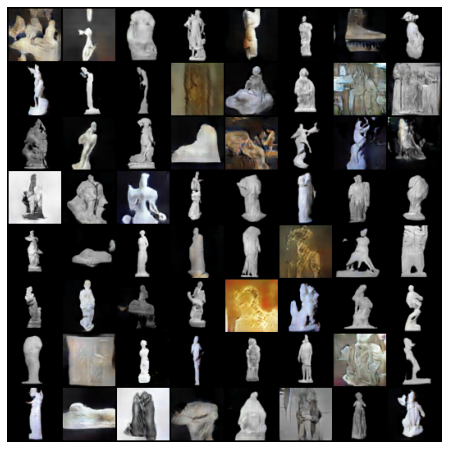

In [15]:
# Animation of generations over time

#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

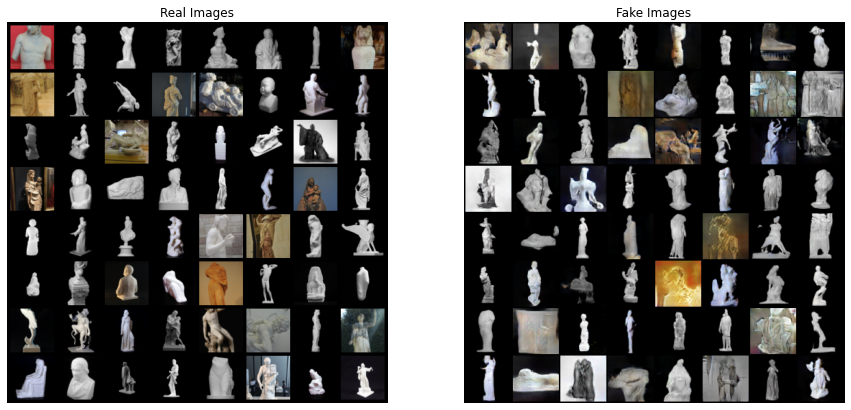

In [16]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.savefig(os.path.join(path,"real_vs_fake_images.png"))

In [17]:
from torchvision.utils import save_image

gen_img_dir = os.path.join(path, "generated_images")
if not os.path.exists(gen_img_dir):
    os.mkdir(gen_img_dir)
im_batch_size = 64
n_images=100
for i_batch in range(0, n_images, im_batch_size):
    gen_images = netG(fixed_noise)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    for i_image in range(gen_images.size(0)):
        save_image(gen_images[i_image, :, :, :], os.path.join(gen_img_dir, f'image_{i_batch+i_image:05d}.png'))

In [18]:
from zipfile import ZipFile
from os.path import basename


zip_file = home_dir + "outputs/" + results_dir + ".zip"
with ZipFile(zip_file, 'w') as zipObj:
   # Iterate over all the files in directory
   for folderName, subfolders, filenames in os.walk(path):
       for filename in filenames:
           #create complete filepath of file in directory
           filePath = os.path.join(folderName, filename)
           # Add file to zip
           zipObj.write(filePath, basename(filePath))